In [1]:
# IMPORTANT: SOME KAGGLE DATA SOURCES ARE PRIVATE
# RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES.
import kagglehub
kagglehub.login()


In [ ]:
import os

print("Dataset root:", mistag_arthropod_taxonomy_orders_object_detection_dataset_path)
print("Contents:", os.listdir(mistag_arthropod_taxonomy_orders_object_detection_dataset_path))


Dataset root: /root/.cache/kagglehub/datasets/mistag/arthropod-taxonomy-orders-object-detection-dataset/versions/6
Contents: ['ArTaxOr']


In [ ]:
import os
import shutil

SRC = os.path.join(mistag_arthropod_taxonomy_orders_object_detection_dataset_path, "ArTaxOr")
TARGET = "/content/arthropod_dataset/ArTaxOr"

# Create target folder
os.makedirs(TARGET, exist_ok=True)

# Copy dataset content
shutil.copytree(SRC, TARGET, dirs_exist_ok=True)

print("✅ Dataset copied successfully!")
print("📌 New dataset path:", TARGET)
print("📂 Contents:", os.listdir(TARGET)[:10])


✅ Dataset copied successfully!
📌 New dataset path: /content/arthropod_dataset/ArTaxOr
📂 Contents: ['Hymenoptera', 'license.txt', 'Diptera', 'Lepidoptera', 'Hemiptera', 'ArTaxOr.png', 'revision history.txt', 'readme.txt', 'Coleoptera', 'Odonata']


## Using the  Dataset

## 🐞 Class: **Hymenoptera**

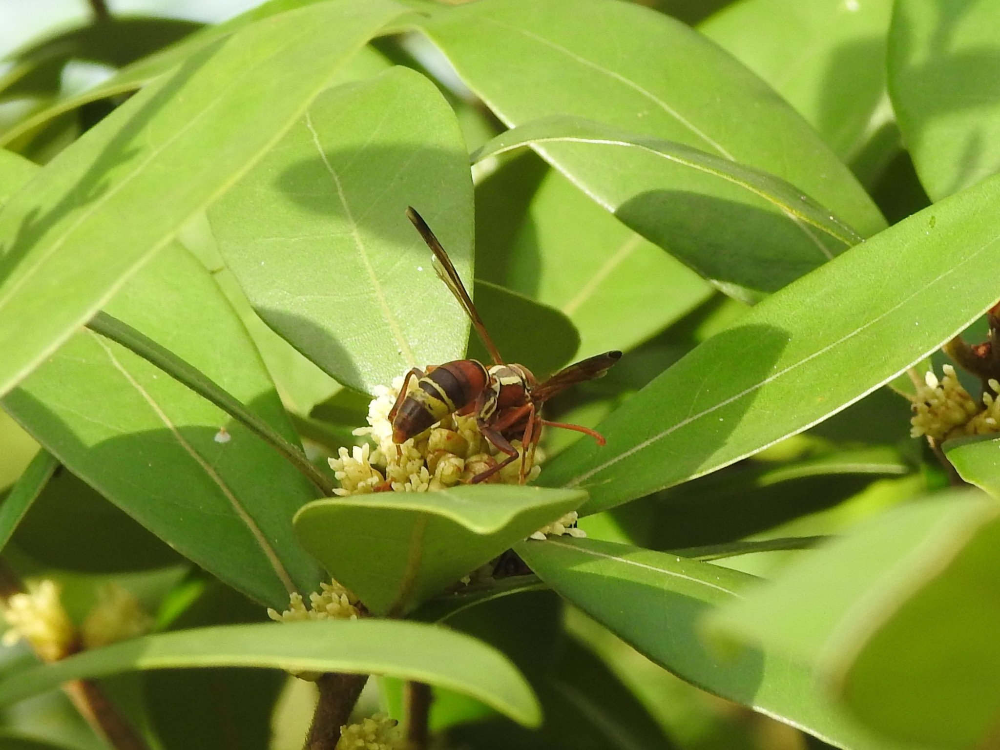

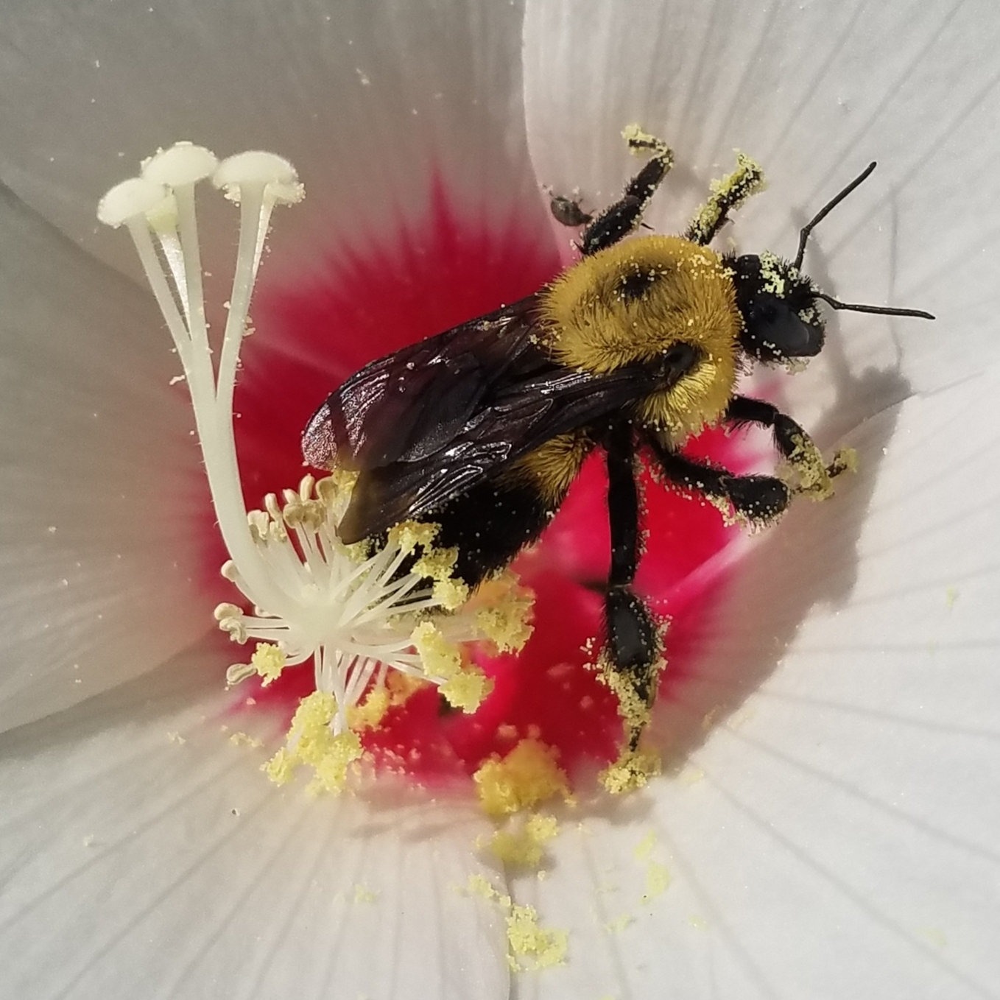

## 🐞 Class: **Diptera**

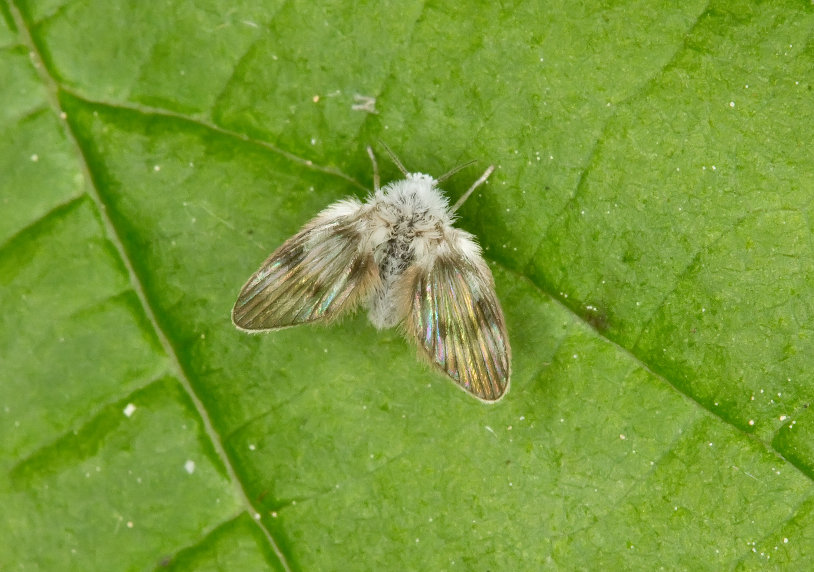

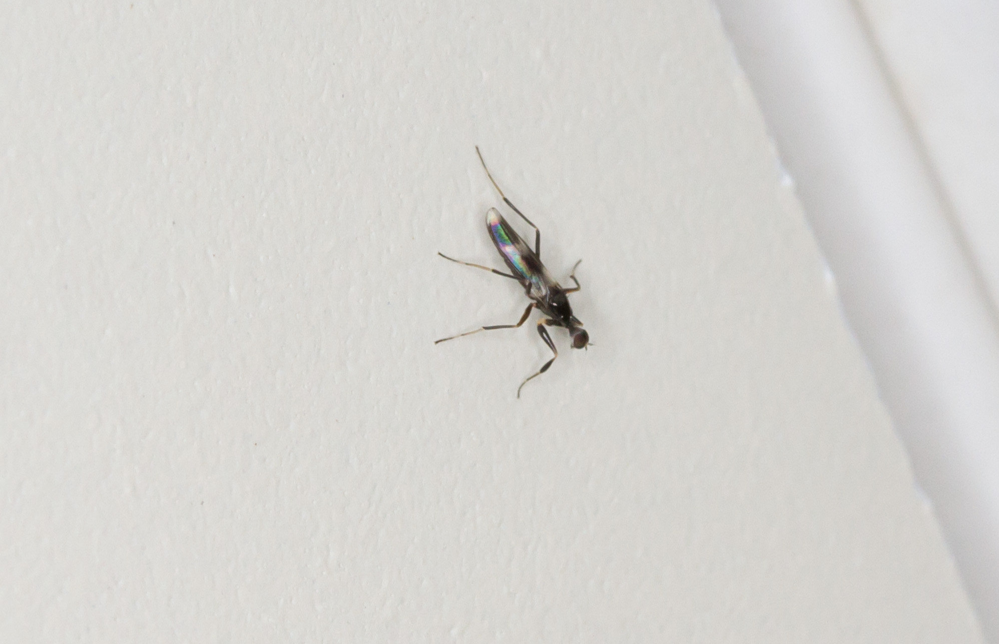

## 🐞 Class: **Lepidoptera**

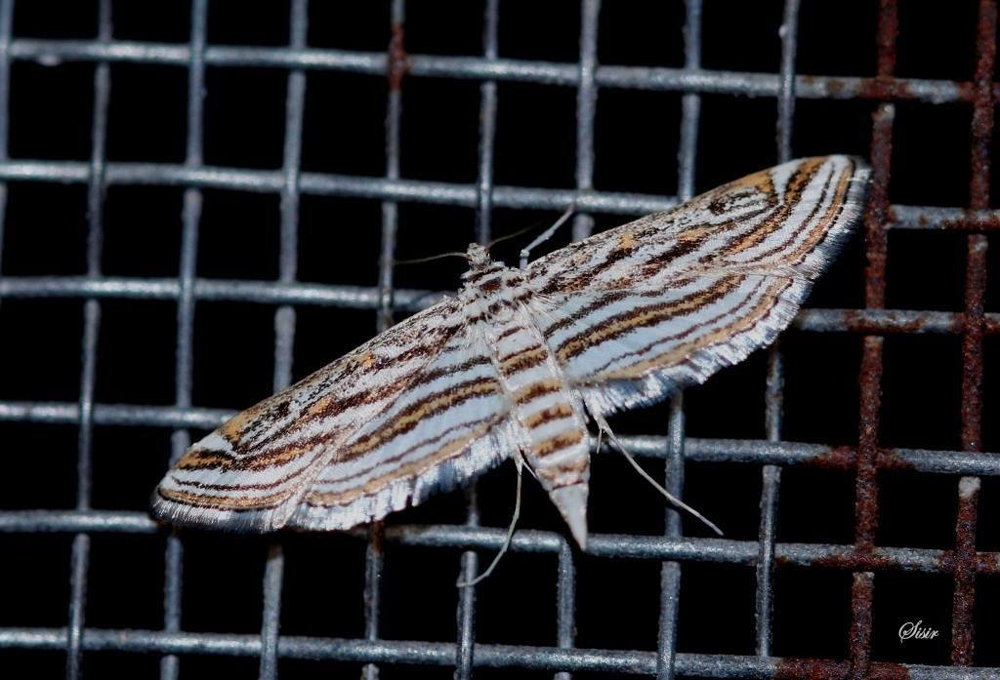

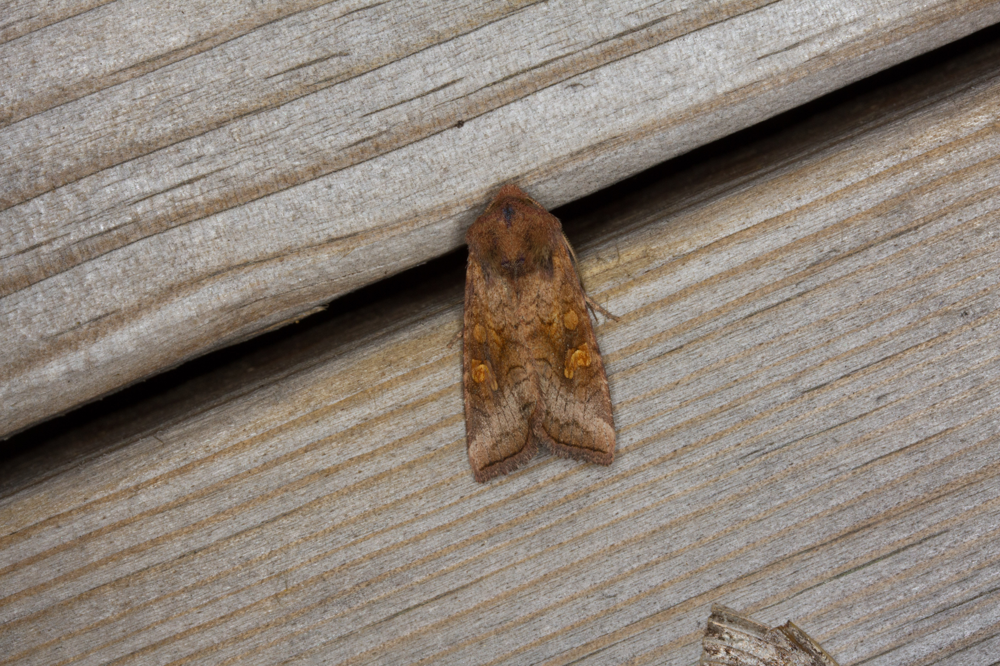

## 🐞 Class: **Hemiptera**

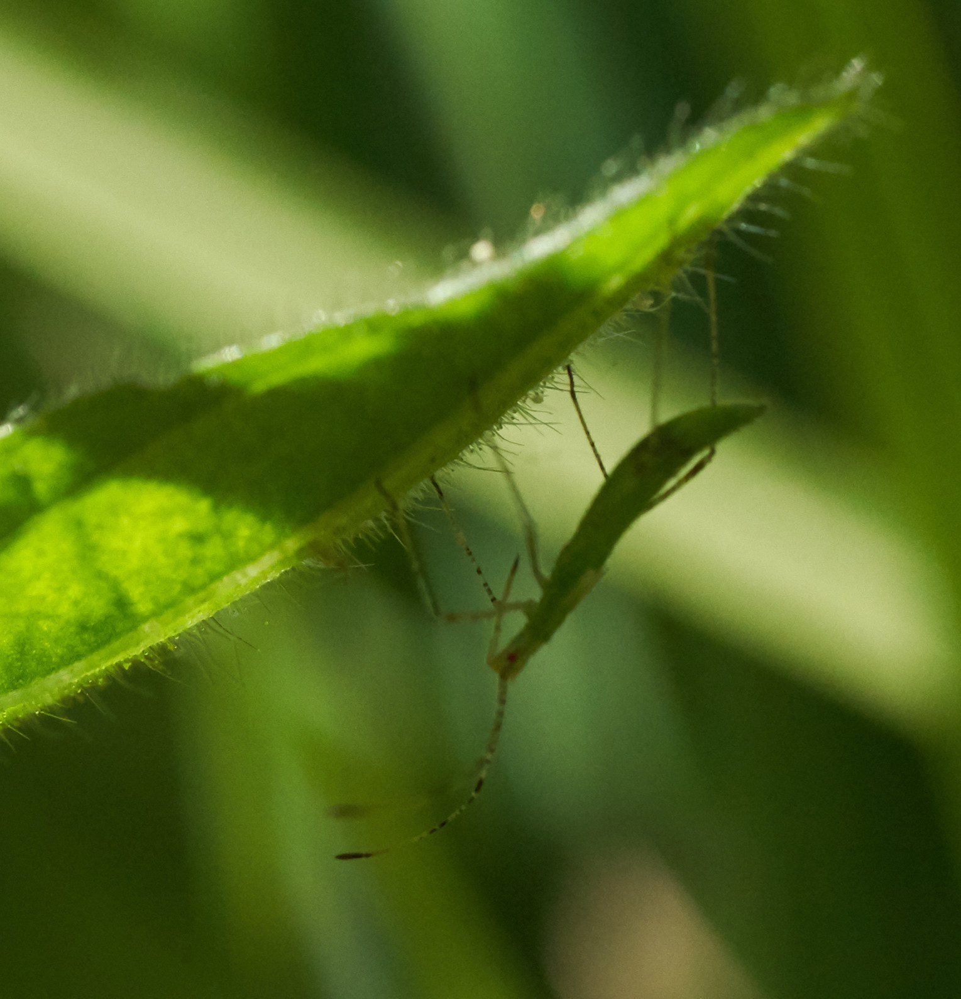

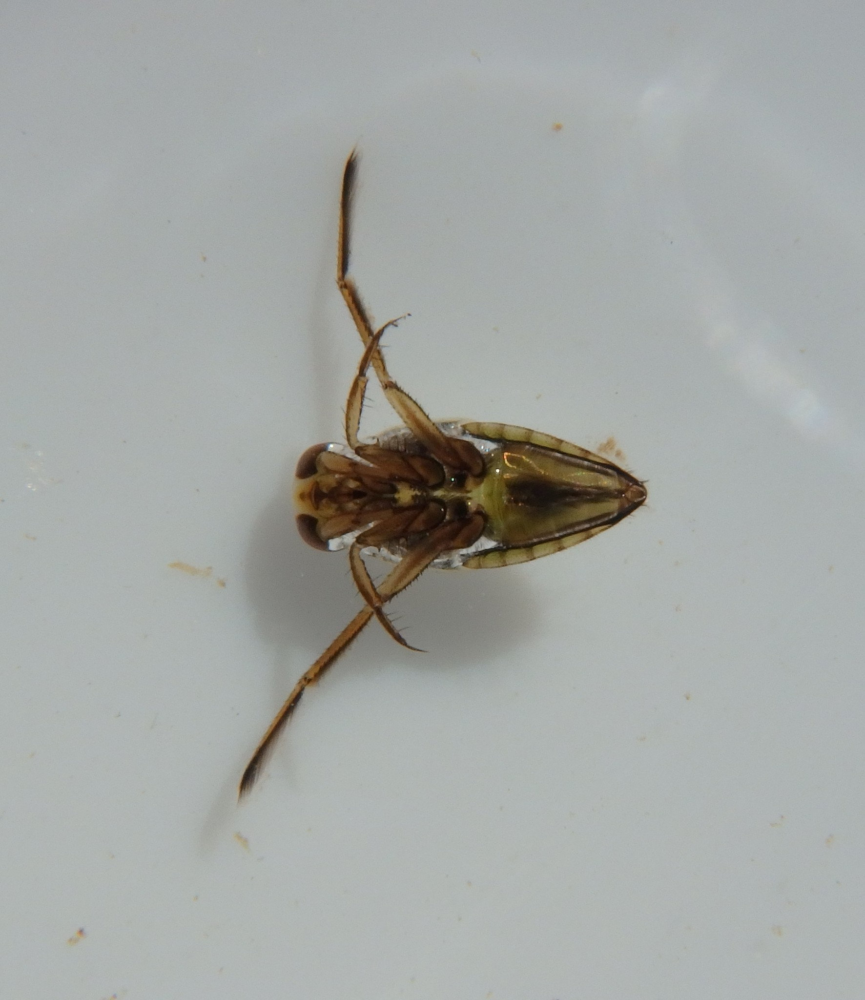

## 🐞 Class: **Coleoptera**

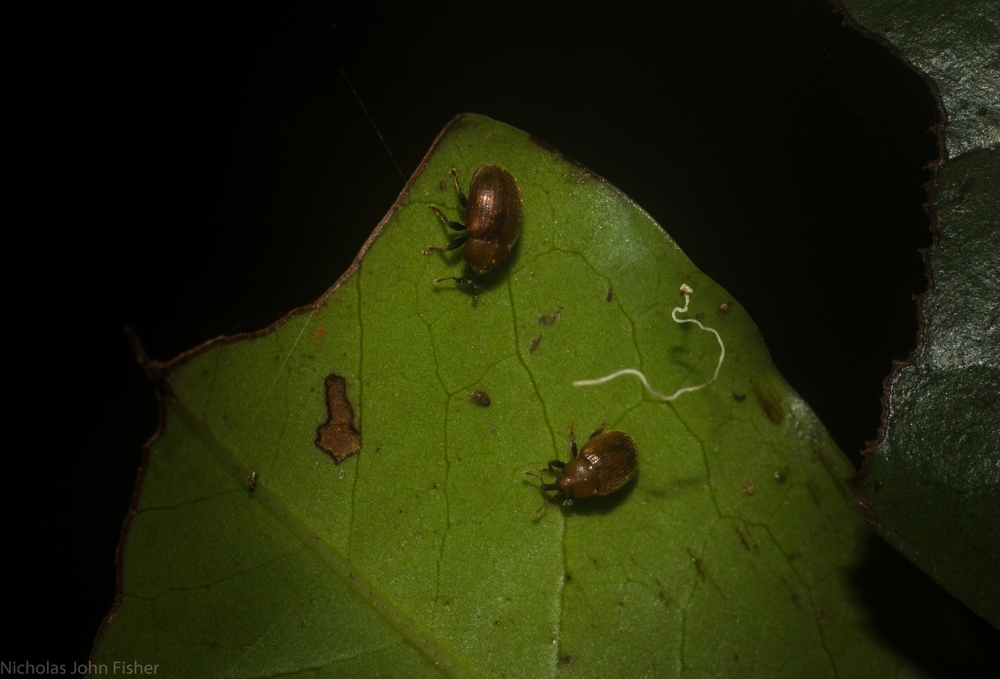

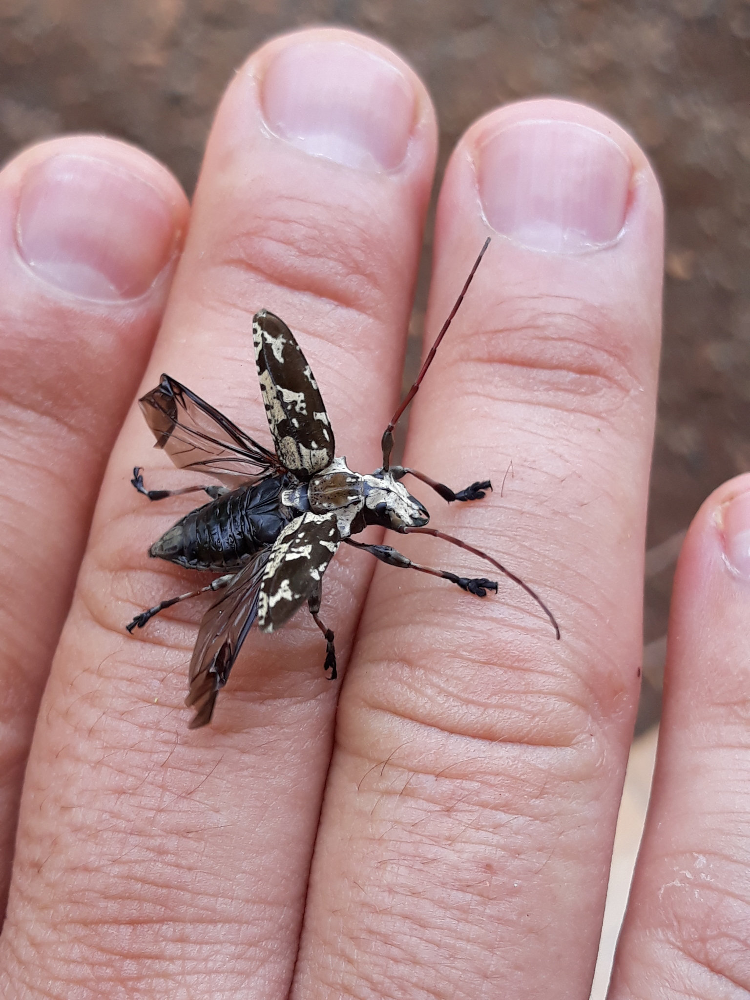

## 🐞 Class: **Odonata**

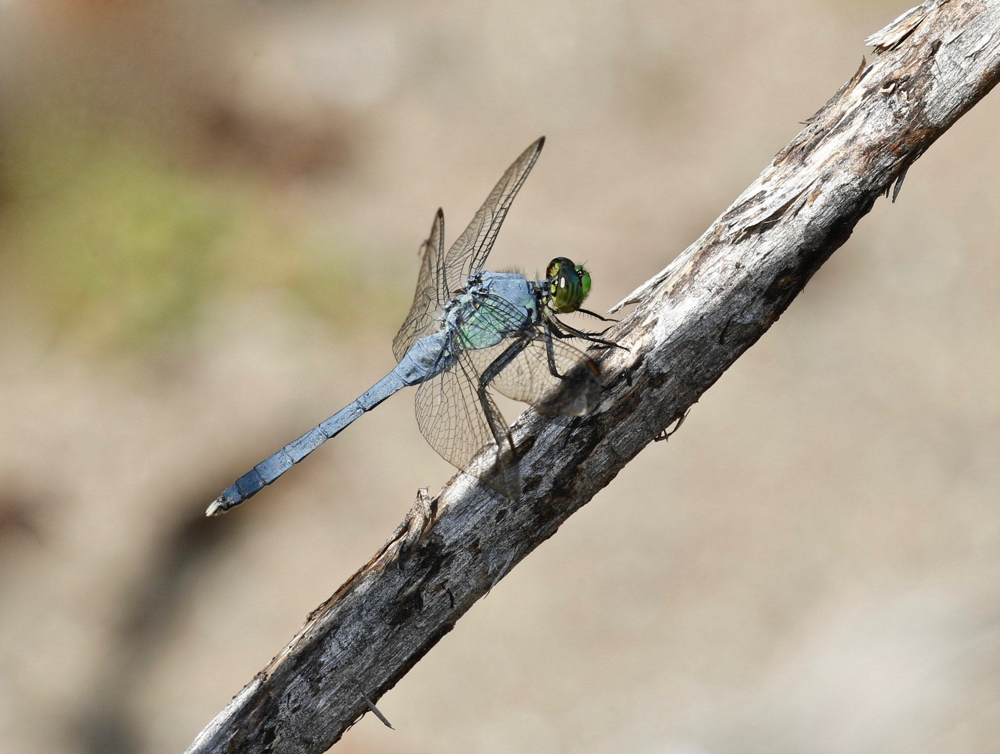

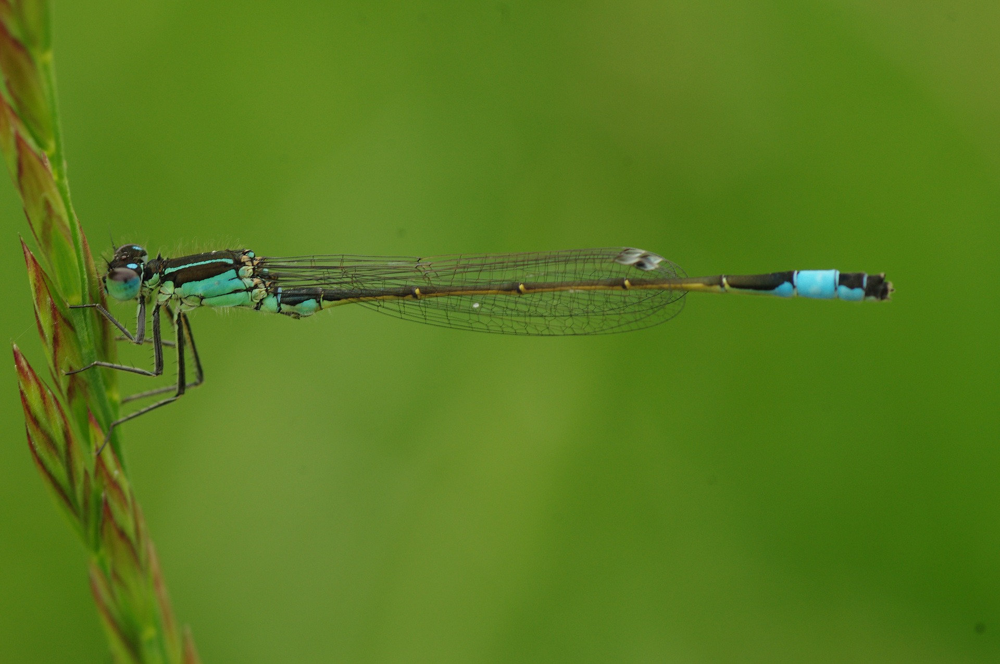

## 🐞 Class: **Araneae**

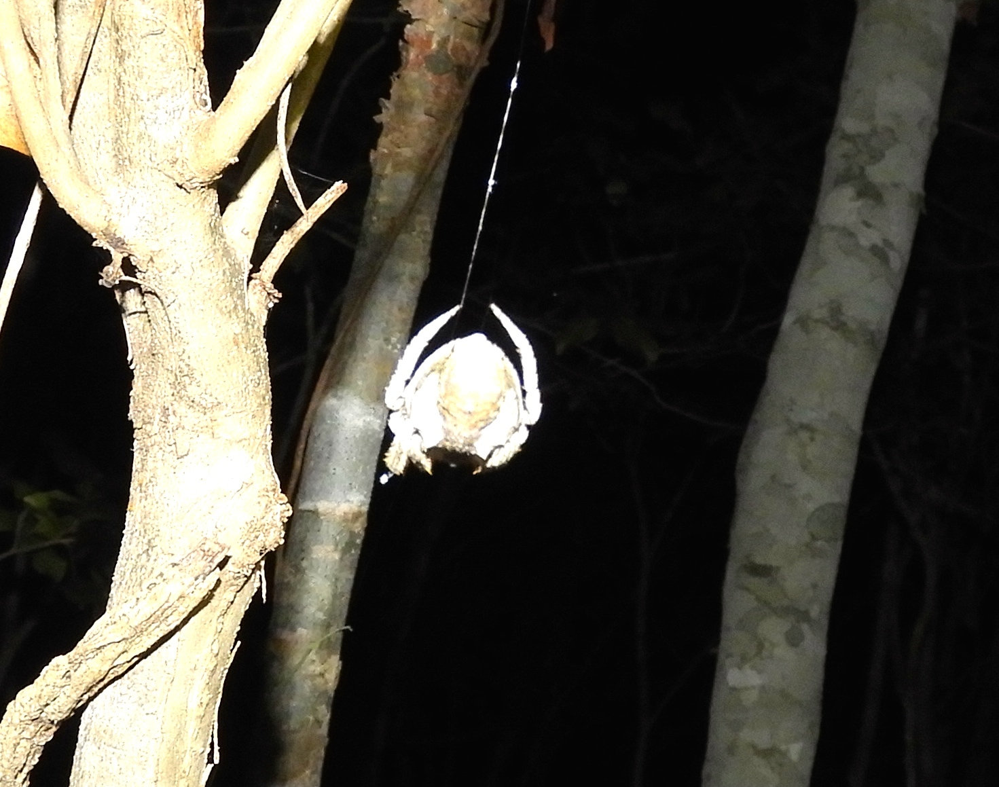

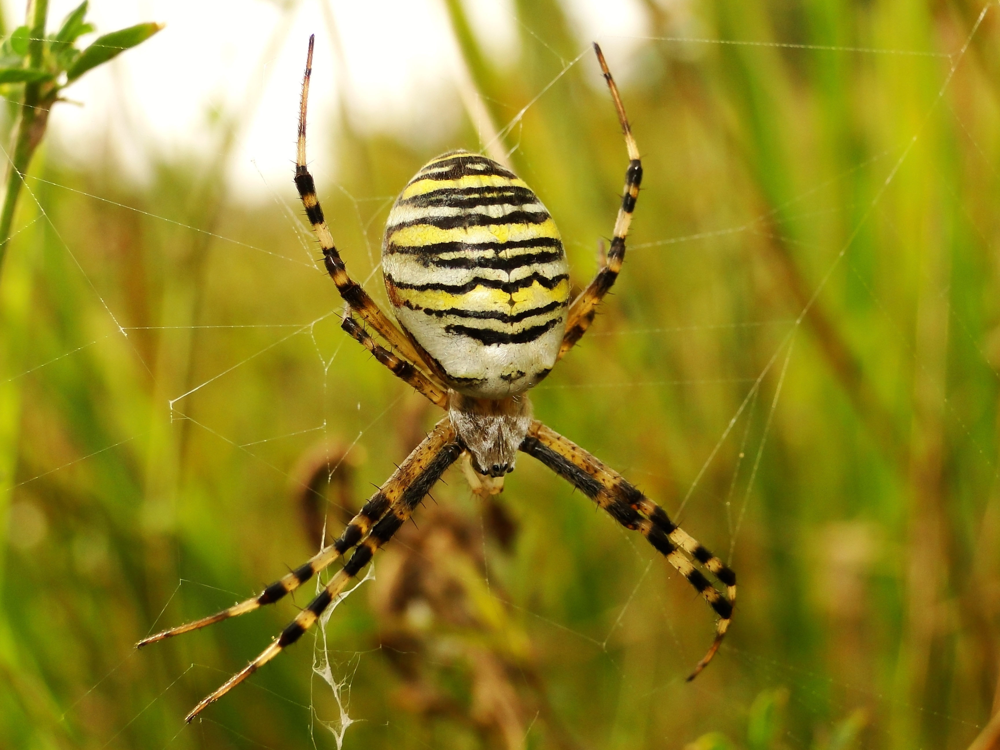

In [ ]:
import os
import random
from IPython.display import display, Image as IPyImage, Markdown

# Dataset path
dataset_path = "/content/arthropod_dataset/ArTaxOr"

# Get all class folder names
folder_names = [folder for folder in os.listdir(dataset_path) if os.path.isdir(os.path.join(dataset_path, folder))]

# Display 2 random images from each class folder
for folder in folder_names:
    folder_path = os.path.join(dataset_path, folder)
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

    # Randomly pick 2 images
    selected_images = random.sample(image_files, 2)

    # Display class name
    display(Markdown(f"## 🐞 Class: **{folder}**"))

    # Display selected images
    for img in selected_images:
        img_path = os.path.join(folder_path, img)
        display(IPyImage(filename=img_path, width=400))


In [ ]:
import os
import json
import shutil
import random
from tqdm import tqdm
from sklearn.model_selection import train_test_split

# ✅ Correct dataset input path
DATASET_PATH = os.path.join(mistag_arthropod_taxonomy_orders_object_detection_dataset_path, "ArTaxOr")

# ✅ Writable output location
RF_DETR_DIR = '/content/DETR_dataset'

# ✅ Create YOLO directory structure
for split in ['train', 'val', 'test']:
    os.makedirs(os.path.join(RF_DETR_DIR, 'images', split), exist_ok=True)
    os.makedirs(os.path.join(RF_DETR_DIR, 'labels', split), exist_ok=True)

all_annotations = {}
class_names = set()

for class_folder in os.listdir(DATASET_PATH):
    class_path = os.path.join(DATASET_PATH, class_folder)
    if not os.path.isdir(class_path):
        continue

    ann_dir = os.path.join(class_path, 'annotations')
    if not os.path.exists(ann_dir):
        continue

    for json_file in os.listdir(ann_dir):
        try:
            with open(os.path.join(ann_dir, json_file), 'r') as f:
                data = json.load(f)
                if 'asset' not in data:
                    continue

                image_name = data['asset']['name']
                all_annotations[image_name] = data

                for region in data.get('regions', []):
                    tags = region.get('tags', [])
                    if tags:
                        class_names.add(tags[0])

        except json.JSONDecodeError:
            continue

class_names = sorted(class_names)
class_to_id = {name: i for i, name in enumerate(class_names)}

# ✅ Collect all image files
image_paths = []
for class_folder in os.listdir(DATASET_PATH):
    class_path = os.path.join(DATASET_PATH, class_folder)
    if not os.path.isdir(class_path):
        continue

    for file in os.listdir(class_path):
        if file.lower().endswith(('.jpg', '.jpeg', '.png')):
            image_paths.append(os.path.join(class_path, file))

# ✅ Split dataset
train_val, test = train_test_split(image_paths, test_size=0.1, random_state=42)
train, val = train_test_split(train_val, test_size=0.111, random_state=42)

def process_dataset(image_paths, split):
    for img_path in tqdm(image_paths, desc=f"Processing {split}"):
        img_name = os.path.basename(img_path)
        if img_name not in all_annotations:
            continue

        data = all_annotations[img_name]
        width = data['asset']['size']['width']
        height = data['asset']['size']['height']

        label_path = os.path.join(RF_DETR_DIR, 'labels', split, img_name.replace('.jpg', '.txt').replace('.png', '.txt'))

        with open(label_path, 'w') as f:
            for region in data.get("regions", []):
                tags = region.get("tags", [])
                if not tags: continue

                cls = class_to_id[tags[0]]
                box = region["boundingBox"]

                xc = (box["left"] + box["width"]/2) / width
                yc = (box["top"] + box["height"]/2) / height
                w = box["width"] / width
                h = box["height"] / height

                f.write(f"{cls} {xc} {yc} {w} {h}\n")

        shutil.copy(img_path, os.path.join(RF_DETR_DIR, 'images', split, img_name))

process_dataset(train, "train")
process_dataset(val, "val")
process_dataset(test, "test")

# ✅ Save YAML
data_yaml = f"""
train: {RF_DETR_DIR}/images/train
val: {RF_DETR_DIR}/images/val
test: {RF_DETR_DIR}/images/test

nc: {len(class_names)}
names: {class_names}
"""

with open(os.path.join(RF_DETR_DIR, 'arthropods.yaml'), "w") as f:
    f.write(data_yaml)

print("✅ YOLO Dataset Created Successfully!")
print("📌 Path:", RF_DETR_DIR)
print("📂", os.listdir(RF_DETR_DIR))


Processing test: 100%|██████████| 1538/1538 [00:14<00:00, 105.65it/s]

✅ YOLO Dataset Created Successfully!
📌 Path: /content/DETR_dataset
📂 ['arthropods.yaml', 'images', 'labels']


In [ ]:
!wget https://github.com/ultralytics/assets/releases/download/v8.3.0/yolo11n.pt


--2025-11-03 11:45:56--  https://github.com/ultralytics/assets/releases/download/v8.3.0/yolo11n.pt
Resolving github.com (github.com)... 140.82.121.3
Connecting to github.com (github.com)|140.82.121.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://release-assets.githubusercontent.com/github-production-release-asset/521807533/34b70ade-b6eb-4179-a60f-d6494307226b?sp=r&sv=2018-11-09&sr=b&spr=https&se=2025-11-03T12%3A27%3A47Z&rscd=attachment%3B+filename%3Dyolo11n.pt&rsct=application%2Foctet-stream&skoid=96c2d410-5711-43a1-aedd-ab1947aa7ab0&sktid=398a6654-997b-47e9-b12b-9515b896b4de&skt=2025-11-03T11%3A27%3A47Z&ske=2025-11-03T12%3A27%3A47Z&sks=b&skv=2018-11-09&sig=hKtXhOGwR3FTHjZ727GHKRy6r4NeeipkgLgOujEZtD4%3D&jwt=eyJ0eXAiOiJKV1QiLCJhbGciOiJIUzI1NiJ9.eyJpc3MiOiJnaXRodWIuY29tIiwiYXVkIjoicmVsZWFzZS1hc3NldHMuZ2l0aHVidXNlcmNvbnRlbnQuY29tIiwia2V5Ijoia2V5MSIsImV4cCI6MTc2MjE3MDY1NiwibmJmIjoxNzYyMTcwMzU2LCJwYXRoIjoicmVsZWFzZWFzc2V0cHJvZHVjdGlvbi5ibG9iLmNvcmUud

In [ ]:
! pip install ultralytics

## Run this cell if Cude out of memeory error came.!

In [ ]:
# import torch
# torch.cuda.empty_cache()

## 🚀 Train YOLOv11 on Custom Dataset

### 🔥 Why YOLOv11?

**YOLOv11** (You Only Look Once - Version 11) is the latest evolution in the YOLO family of object detection models, known for its **speed, efficiency, and accuracy**. It is specifically designed to balance **real-time performance** with **high precision**, making it ideal for a wide range of object detection tasks, from **autonomous vehicles** to **wildlife monitoring** and **industrial inspection**.

**Significance of YOLOv11:**
- **Lightweight and Fast:** Optimized for both edge devices and high-end GPUs.
- **Improved Accuracy:** Enhanced backbone and detection heads over previous versions.
- **Better Generalization:** Performs well on both small and large object detection.
- **Flexible:** Supports custom datasets, including multi-class object detection with ease.
- **State-of-the-art Results:** Competes with large Transformer-based models while being much faster.

If you are looking for a **high-speed, accurate, and scalable object detector**, YOLOv11 is one of the best choices.

---

### ⚙️ Choosing the Right `batch_size`

The amount of **GPU VRAM** limits how much data can be processed at once. You can tune two important parameters:
- `batch_size`: Number of images processed in one iteration.
- `grad_accum_steps`: Number of steps over which gradients are accumulated before an optimizer step.

The recommended strategy is to maintain the product of `batch_size × grad_accum_steps = 16`.  
This ensures stable learning across different hardware:

| GPU Type          | batch_size | grad_accum_steps |
|-------------------|:---------:|:---------------:|
| NVIDIA A100      |    16     |        1        |
| NVIDIA T4        |     4     |        4        |
| RTX 3060         |     2     |        8        |

The **gradient accumulation** strategy allows simulation of a larger batch size even on GPUs with limited memory, ensuring training stability and better convergence.

---

### 🚀 Multi-GPU Training (Optional)

For faster training and large-scale datasets, YOLOv11 supports **multi-GPU parallel training** using **PyTorch Distributed Data Parallel (DDP)**.

You can launch multi-GPU training using:

```bash
python -m torch.distributed.launch \
    --nproc_per_node=8 \
    --use_env \
    main.py
```
Replace `8` with the number of GPUs available.  
When using multiple GPUs, remember:
- The **effective batch size** becomes `batch_size × number_of_GPUs`.
- Adjust `batch_size` and `grad_accum_steps` accordingly to maintain consistency.

---

### ✅ Why YOLOv11 for Your Custom Dataset?

- It can easily adapt to **any number of custom classes**.
- Suitable for datasets with **small objects, complex backgrounds, and class imbalance**.
- Fast inference and low latency — ideal for **real-time applications** like **drones, surveillance, and robotics**.
- Provides built-in metrics like **mAP, Precision, Recall, F1-Score, and Confusion Matrix** for easy evaluation.



In [ ]:
import os
from ultralytics import YOLO
import matplotlib.pyplot as plt

# Step 1: Load Pretrained YOLOv11 model
model = YOLO("/content/yolo11n.pt")

# Step 2: Train on custom dataset
results = model.train(
    data=os.path.join(RF_DETR_DIR, 'arthropods.yaml'),  # path to data.yaml
    epochs=5,  # Increase epochs for better results
    imgsz=640,
    batch=16,
    device=0,
    name="yolov11_custom",
    resume=False
)

print("Training complete! Results saved in:", results.save_dir)



Ultralytics 8.3.223 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/DETR_dataset/arthropods.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=5, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolov11_custom4, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective

In [ ]:
!ls runs/detect/yolov11_custom



args.yaml  weights


### 📌 Confusion Matrix

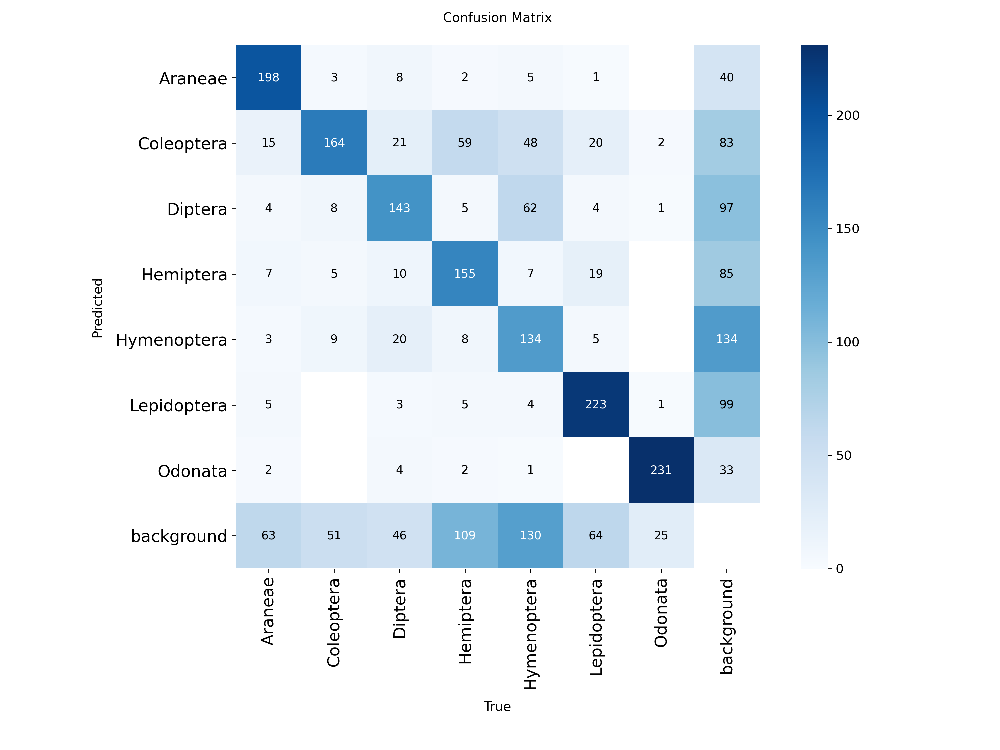

### 📌 Confusion Matrix (Normalized)

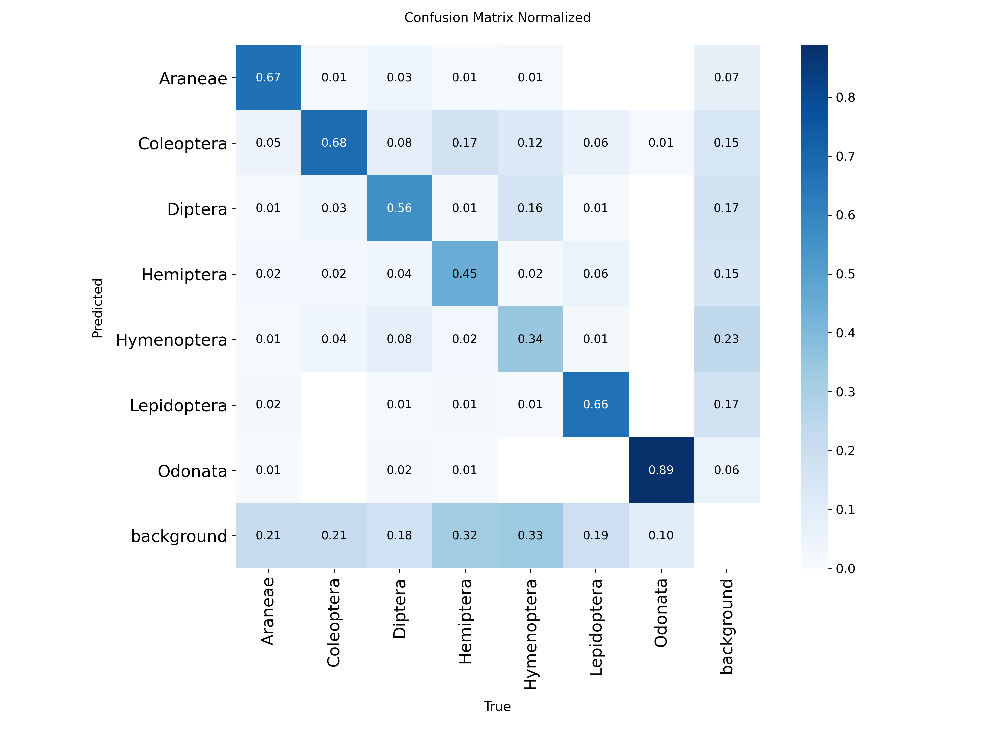

⚠️ Missing: F1_curve.png
⚠️ Missing: P_curve.png
⚠️ Missing: R_curve.png
⚠️ Missing: PR_curve.png
⚠️ Missing: labels_correlogram.jpg


### 📌 Labels

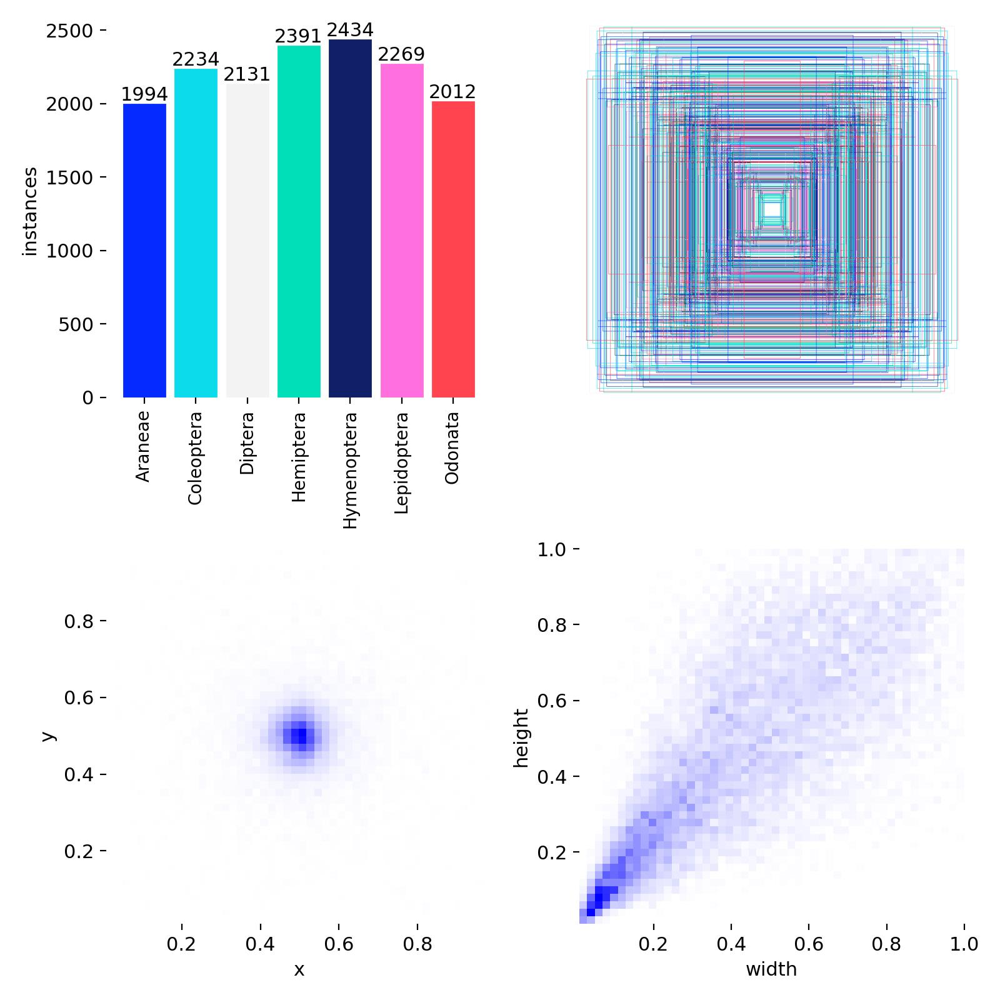

### 📌 Training & Validation Metrics

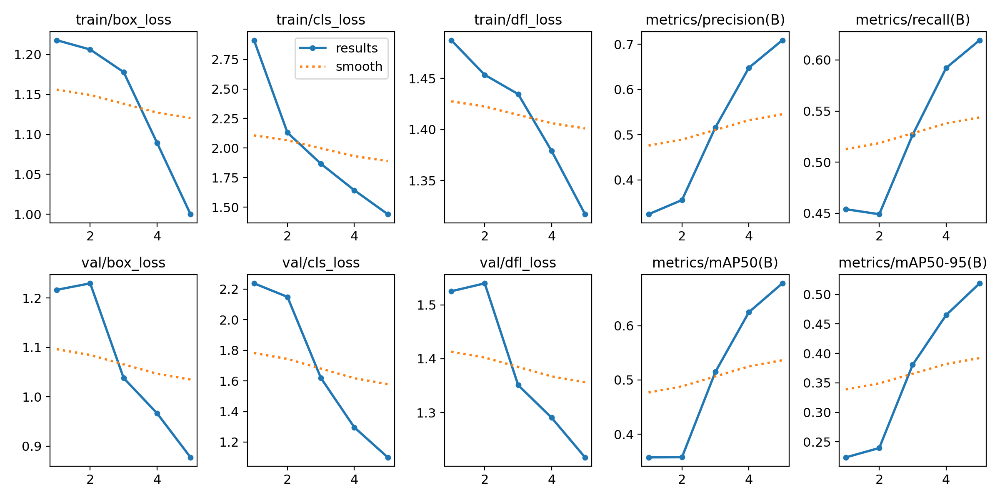

### 📌 Train Batch 0

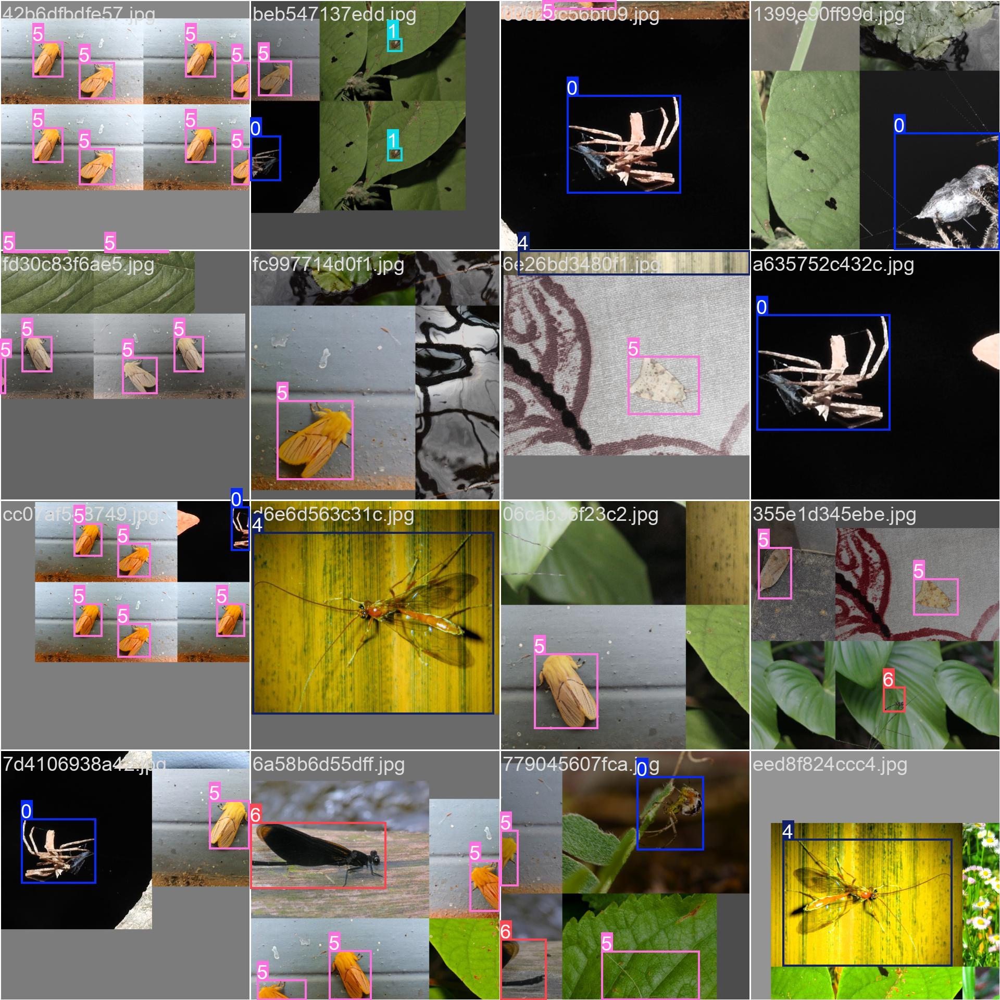

### 📌 Train Batch 1

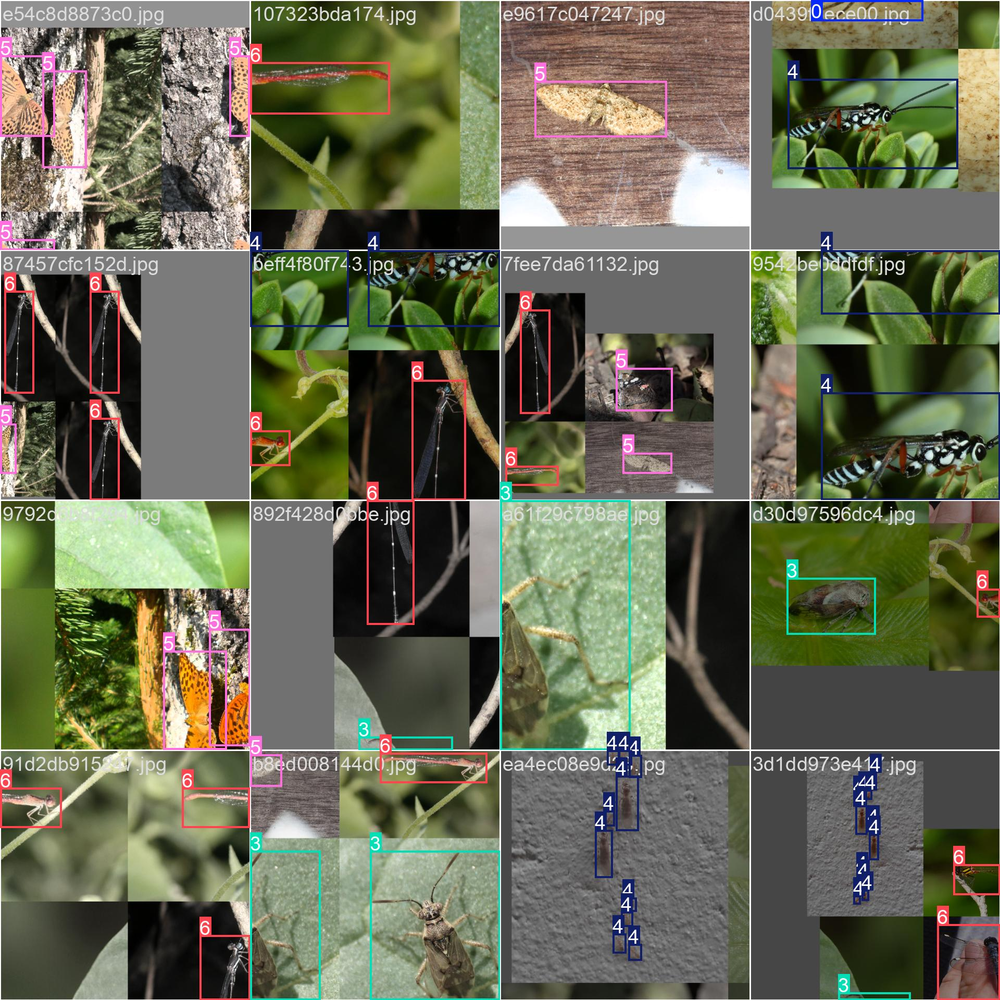

### 📌 Train Batch 2

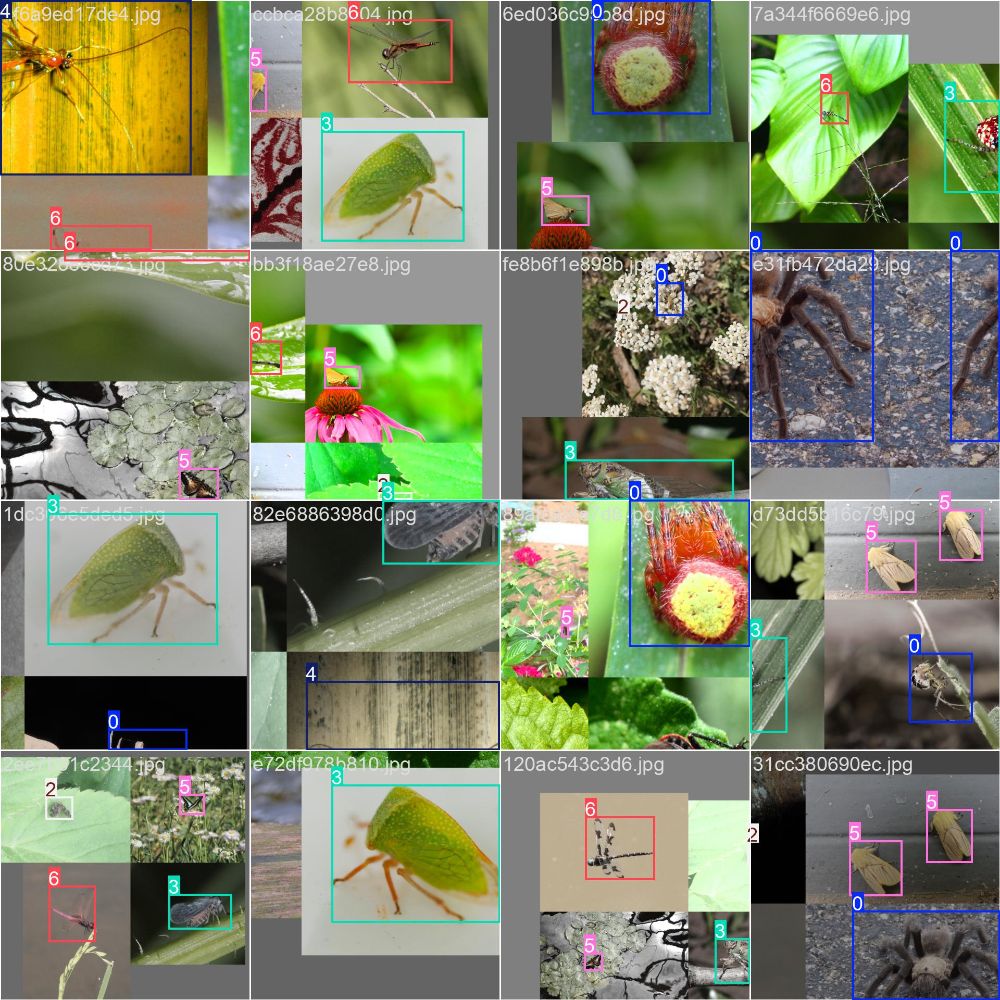

### 📌 Validation Batch 0 Labels

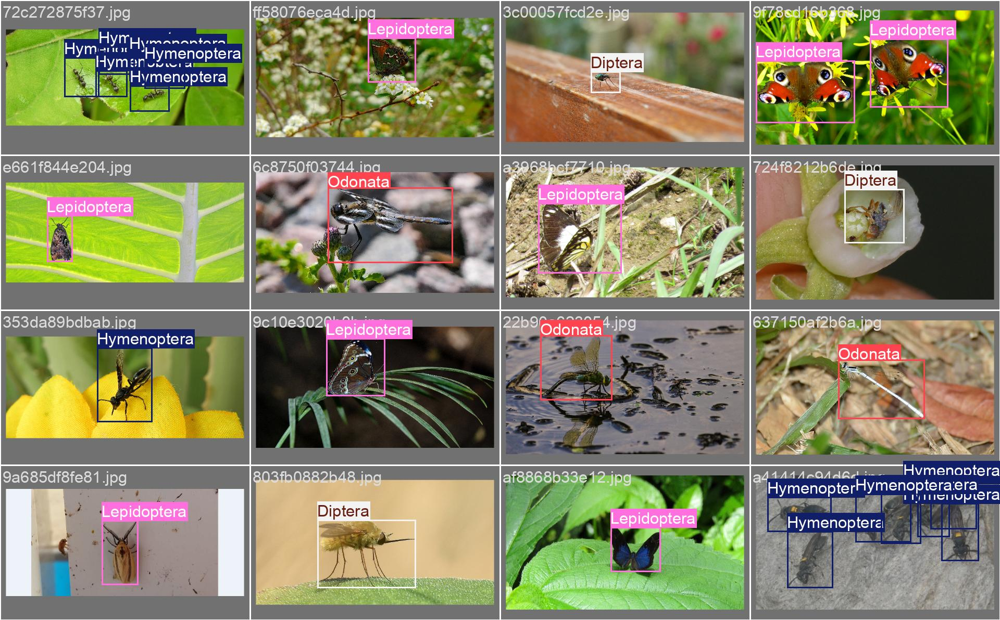

### 📌 Validation Batch 0 Prediction

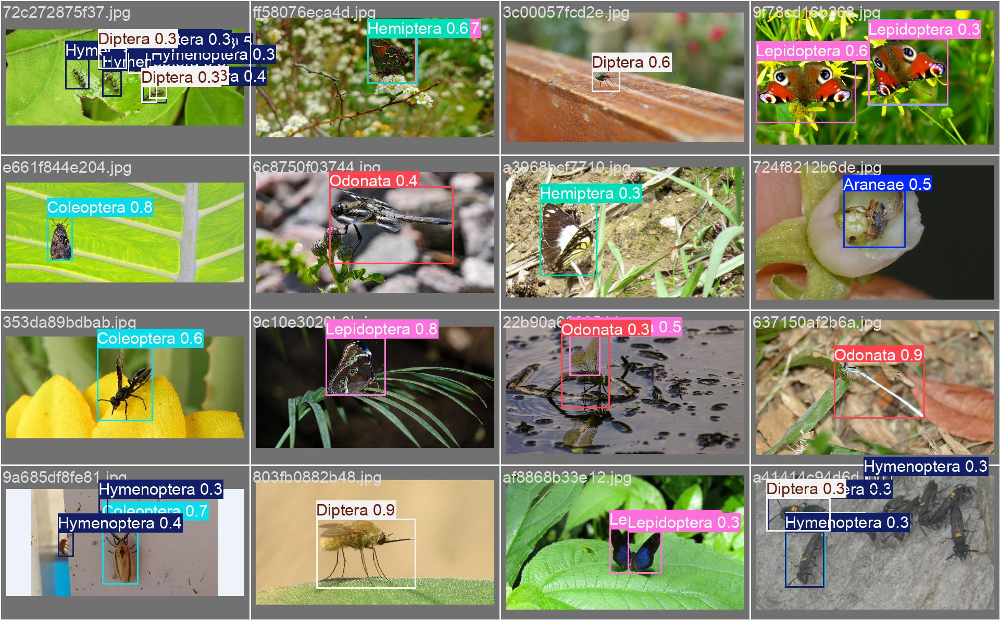

### 📌 Validation Batch 1 Labels

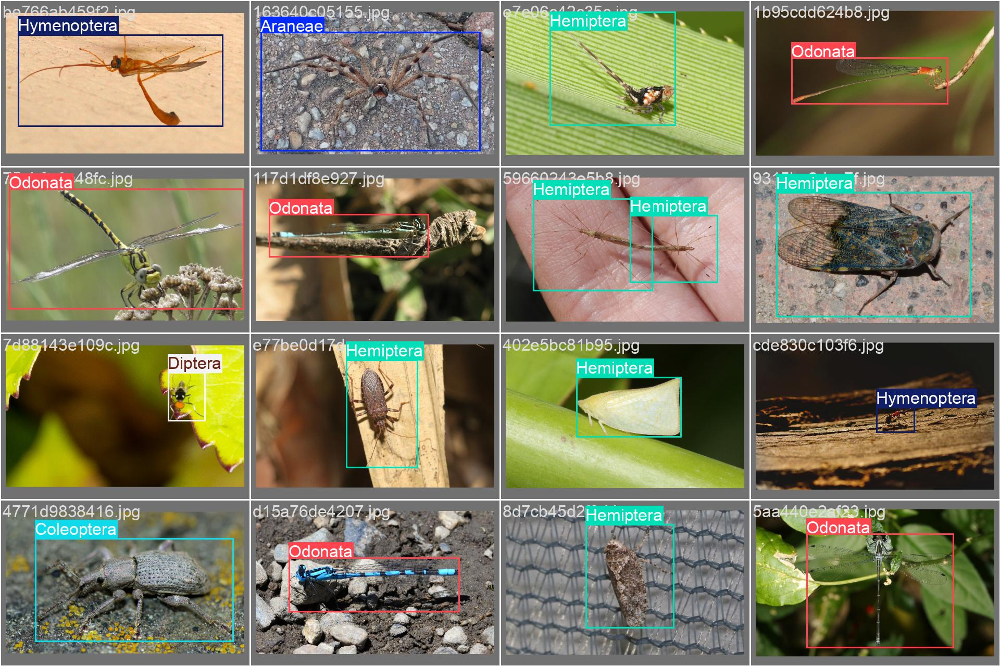

### 📌 Validation Batch 1 Prediction

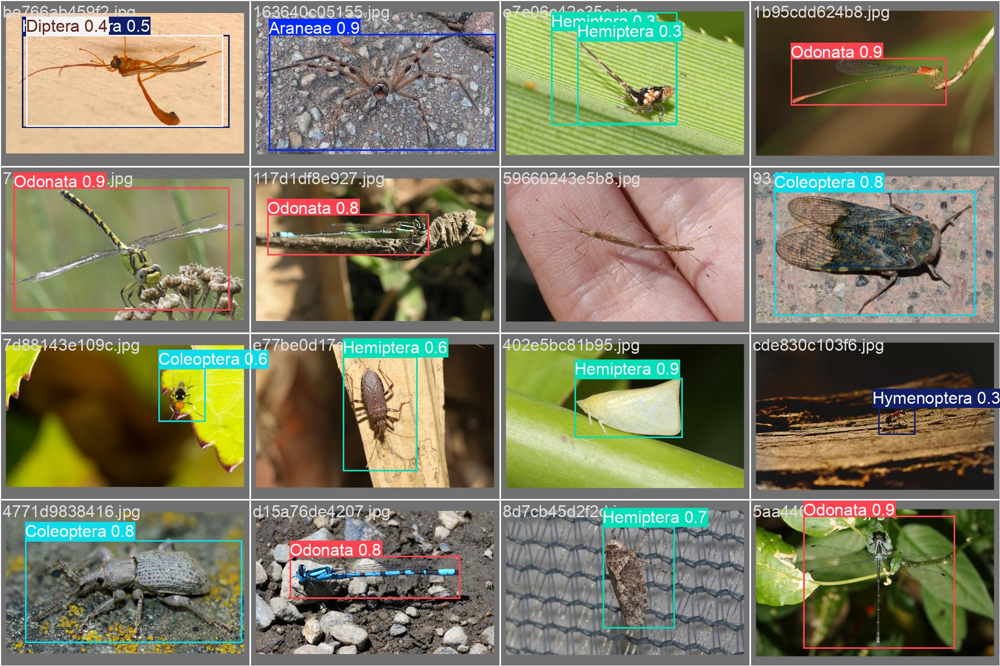

### 📌 Validation Batch 2 Labels

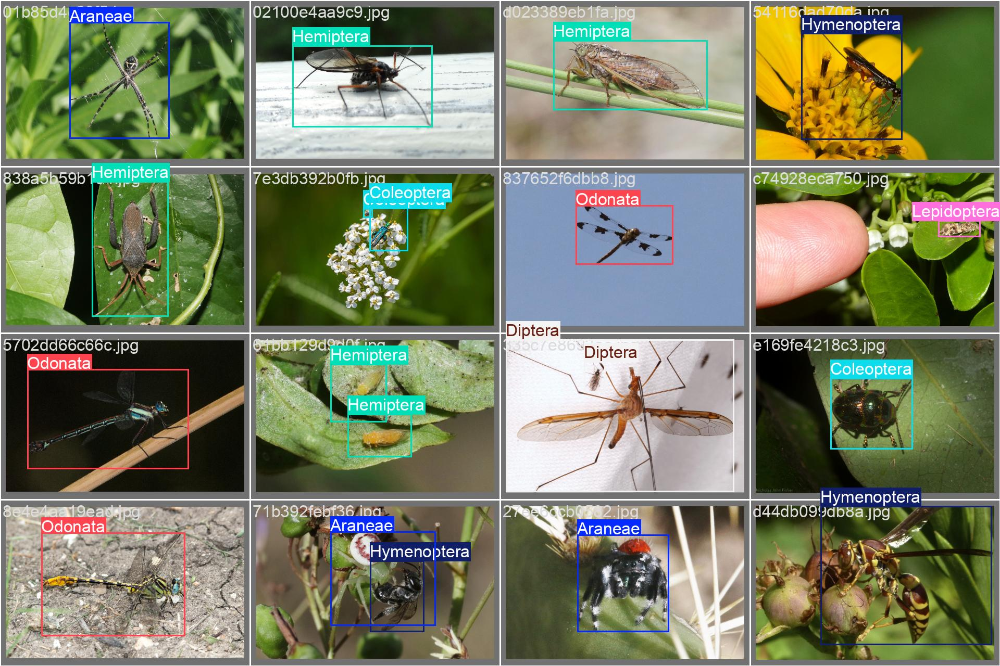

### 📌 Validation Batch 2 Prediction

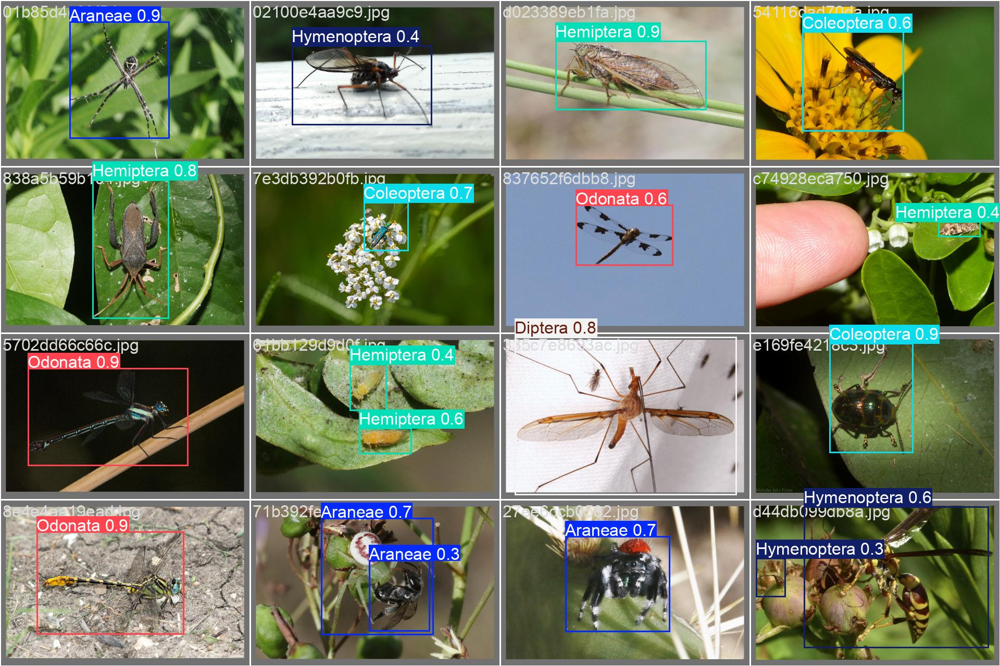

In [ ]:
import os
from IPython.display import display, Image as IPyImage, Markdown

# ✅ Correct results directory path
result_dir = "/content/runs/detect/yolov11_custom4"

# List of images to display
image_info = [
    ("Confusion Matrix", "confusion_matrix.png"),
    ("Confusion Matrix (Normalized)", "confusion_matrix_normalized.png"),
    ("F1 Score Curve", "F1_curve.png"),
    ("Precision Curve", "P_curve.png"),
    ("Recall Curve", "R_curve.png"),
    ("Precision-Recall Curve", "PR_curve.png"),
    ("Labels Correlogram", "labels_correlogram.jpg"),
    ("Labels", "labels.jpg"),
    ("Training & Validation Metrics", "results.png"),
    ("Train Batch 0", "train_batch0.jpg"),
    ("Train Batch 1", "train_batch1.jpg"),
    ("Train Batch 2", "train_batch2.jpg"),
    ("Validation Batch 0 Labels", "val_batch0_labels.jpg"),
    ("Validation Batch 0 Prediction", "val_batch0_pred.jpg"),
    ("Validation Batch 1 Labels", "val_batch1_labels.jpg"),
    ("Validation Batch 1 Prediction", "val_batch1_pred.jpg"),
    ("Validation Batch 2 Labels", "val_batch2_labels.jpg"),
    ("Validation Batch 2 Prediction", "val_batch2_pred.jpg")
]

# Display images if they exist
for title, img_file in image_info:
    img_path = os.path.join(result_dir, img_file)
    if os.path.exists(img_path):  # ✅ Check before loading
        display(Markdown(f"### 📌 {title}"))
        display(IPyImage(filename=img_path, width=600))
    else:
        print(f"⚠️ Missing: {img_file}")


# Result of Training


image 1/1 /content/DETR_dataset/images/val/8e4b8296f9b9.jpg: 448x640 1 Coleoptera, 10.4ms
Speed: 3.1ms preprocess, 10.4ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


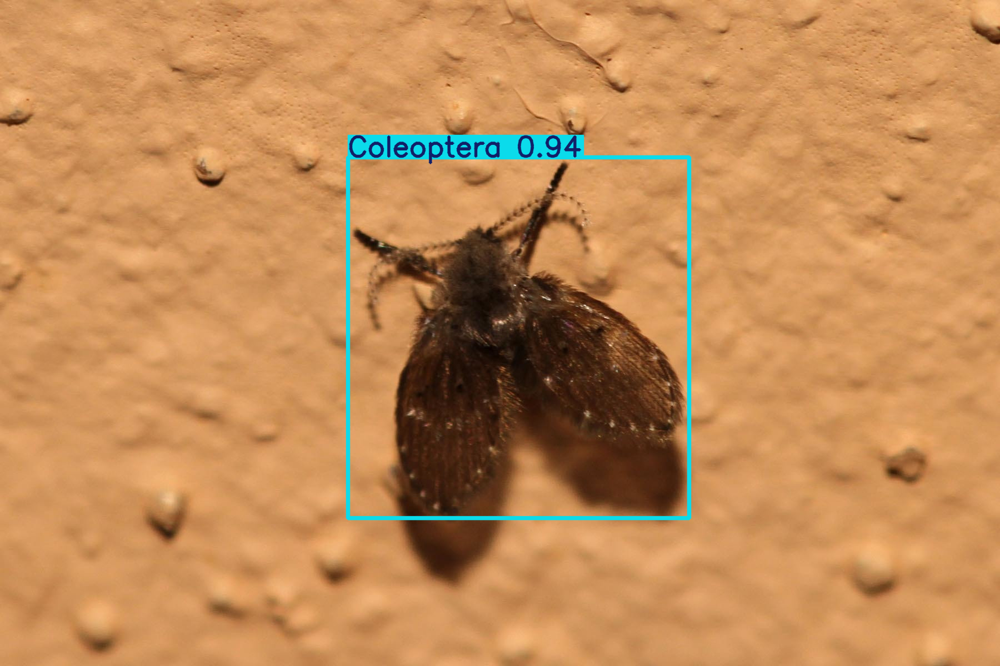


image 1/1 /content/DETR_dataset/images/val/cb464343e1ba.jpg: 544x640 1 Hemiptera, 13.5ms
Speed: 4.3ms preprocess, 13.5ms inference, 1.9ms postprocess per image at shape (1, 3, 544, 640)


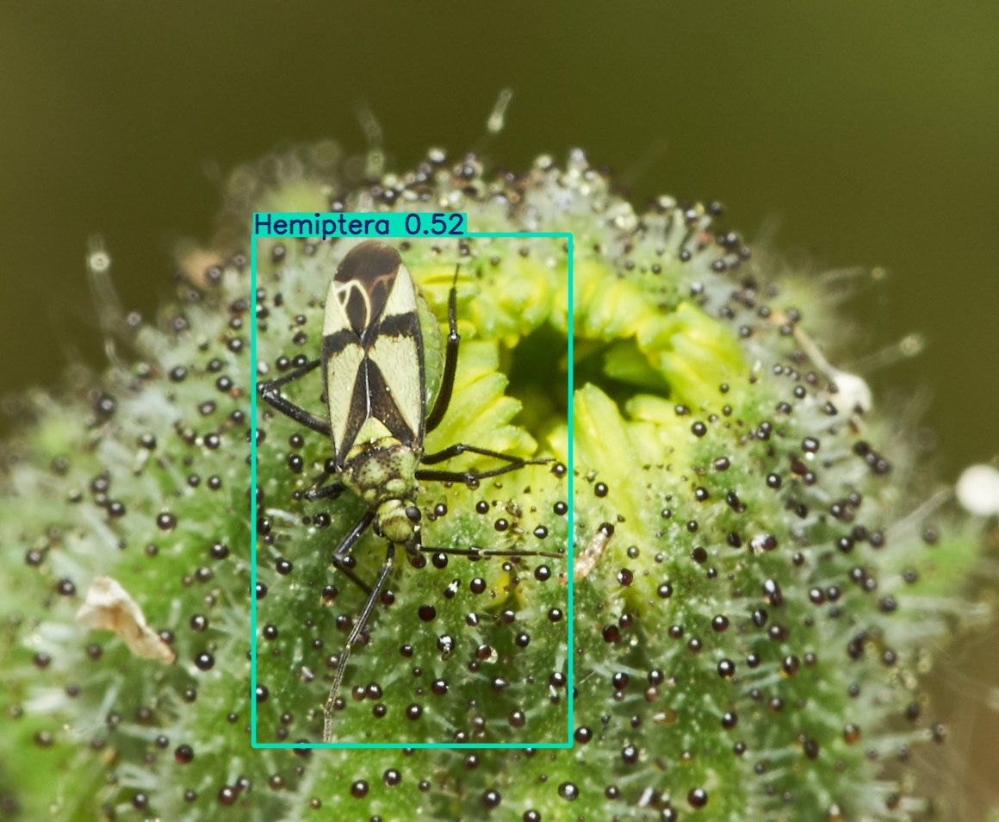


image 1/1 /content/DETR_dataset/images/val/58ee3c11de26.jpg: 448x640 1 Lepidoptera, 15.1ms
Speed: 6.8ms preprocess, 15.1ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


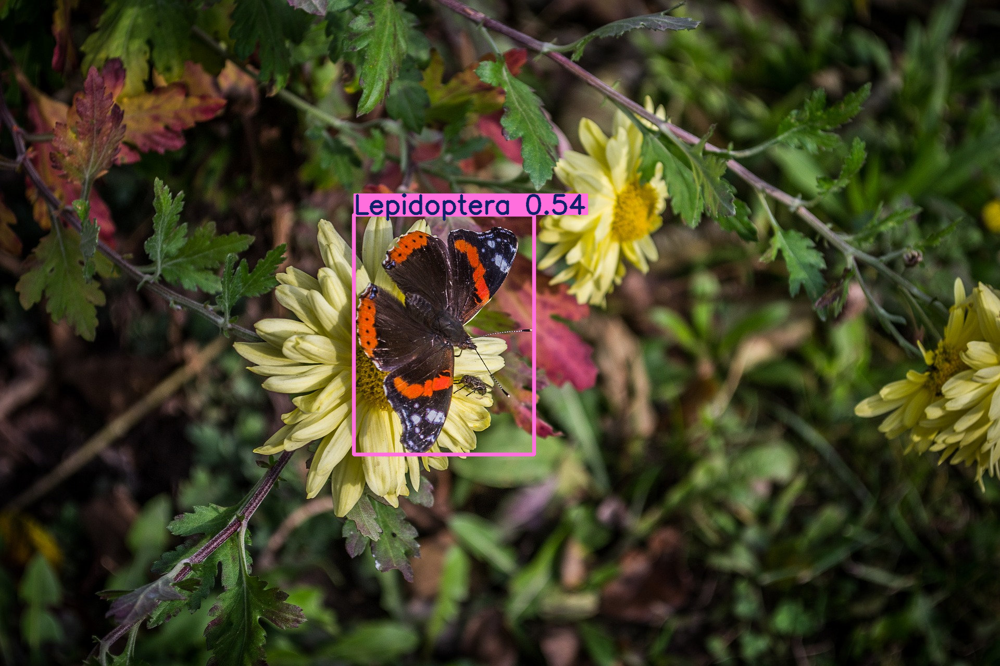


image 1/1 /content/DETR_dataset/images/val/dcfb0bdbaf87.jpg: 480x640 1 Hemiptera, 15.0ms
Speed: 4.0ms preprocess, 15.0ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


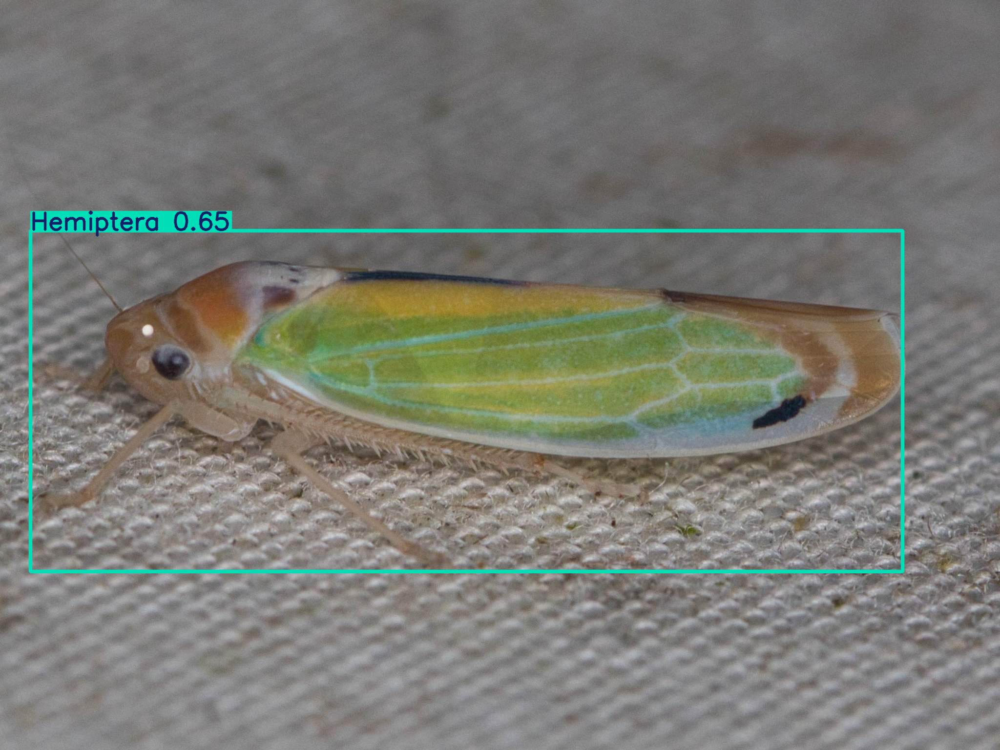


image 1/1 /content/DETR_dataset/images/val/b4eee80fb8f3.jpg: 480x640 1 Lepidoptera, 11.0ms
Speed: 4.3ms preprocess, 11.0ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


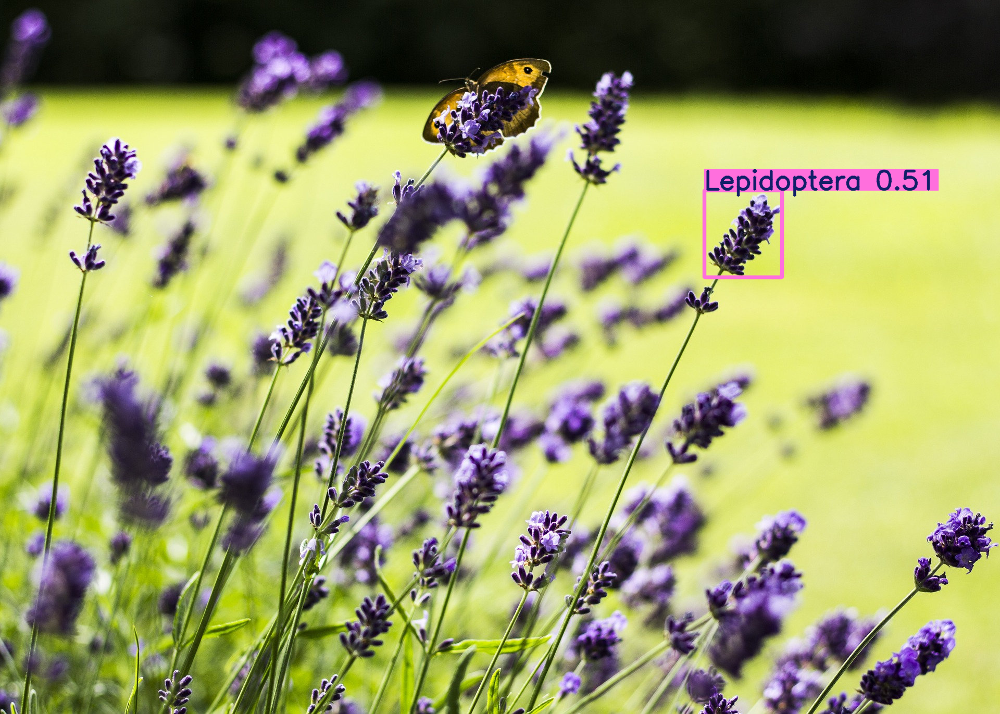

In [ ]:
val_img_dir = os.path.join(RF_DETR_DIR, 'images', 'val')
sample_images = os.listdir(val_img_dir)[:5]

for img_name in sample_images:
    img_path = os.path.join(val_img_dir, img_name)
    preds = model.predict(img_path, conf=0.5)
    preds[0].show()
